In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
# read thermo data

# read the thermo data
tf_data = pd.read_csv('Thermo_Fisher_Merged_All_UniProt_Imputed.csv')
display(tf_data.head())

#count the numbr of columns where tech_rep is 1
tf_data['tech_rep'].value_counts()

tf_data_rep1 = tf_data[tf_data['tech_rep'] == 1]
tf_data_rep2 = tf_data[tf_data['tech_rep'] == 2]

# rearrange the rows in ascending order of FREG0_PID column
tf_data_rep1 = tf_data_rep1.sort_values(by='FREG0_PID')
tf_data_rep1 = tf_data_rep1.set_index('FREG0_PID')
display(tf_data_rep1.head())

# protein data
tf_prot_1 = tf_data_rep1.iloc[:,10:]

#set the tf_prot_1 index to the same as tf_data_rep1
tf_prot_1.index = tf_data_rep1.index
display(tf_prot_1.head())

'''tf_prot_1.columns = [
    col.split(';')[0].split('-')[0] if (';' in col or '-' in col) else col
    for col in tf_prot_1.columns
]'''

tf_prot_cols = tf_prot_1.columns

,FREG0_PID,FREG1_Barcode,FREG14_Visit_number,tech_rep_id,bio_rep_id,tech_rep,TF_ID,biosample_id,plate_id,SampleType,...,Q9Y6W5,Q9Y6X5,Q9Y6X6,Q9Y6Y8,Q9Y6Y9,Q9Y6Z7,V9GYE7,V9GYJ8,X5CMH5,X6R3N0
0,SHB-1416-3,9438,1,Y,N,1,TF_1001,2137908201,2024ms0632,Experimental,...,15.185995,13.914931,15.468603,14.008394,12.375359,18.693348,14.367601,14.798474,13.456067,14.626384
1,SHB-2486-5,8626,1,Y,N,2,TF_1002,2137908874,2024ms0632,Experimental,...,13.842663,12.605233,15.134020,12.954799,11.320237,18.078045,14.429881,14.506410,12.357013,15.237267
2,SHA-8891-2,9151,1,Y,N,1,TF_1003,2137800109,2024ms0632,Experimental,...,14.527151,13.475052,15.727801,12.724708,12.112896,18.244337,14.847401,14.582424,13.051454,15.403491
3,SHA-4242-2,8318,1,Y,N,1,TF_1004,2137802984,2024ms0633,Experimental,...,15.087375,12.643798,15.284726,13.734045,12.212947,17.781231,13.790802,14.192914,12.499873,14.653014
4,SHA-2125-1,8582,1,Y,N,1,TF_1005,2137908873,2024ms0633,Experimental,...,14.783981,12.402738,16.002589,13.126559,12.317233,17.900482,14.043732,14.698194,12.637876,14.841877


,FREG1_Barcode,FREG14_Visit_number,tech_rep_id,bio_rep_id,tech_rep,TF_ID,biosample_id,plate_id,SampleType,A0A024R4E5,...,Q9Y6W5,Q9Y6X5,Q9Y6X6,Q9Y6Y8,Q9Y6Y9,Q9Y6Z7,V9GYE7,V9GYJ8,X5CMH5,X6R3N0
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHA-0700-3,9651,1,Y,N,1,TF_1075,2137802901,2024ms0632,Experimental,12.062057,...,14.770426,12.526153,15.407704,12.726809,11.716662,18.050916,13.519954,14.373176,12.272806,15.017125
SHA-0720-1,9609,1,Y,N,1,TF_1033,2137802891,2024ms0632,Experimental,11.623149,...,14.327440,11.932937,15.418695,12.526996,11.258556,17.812488,14.473262,14.697214,12.244847,15.439723
SHA-0723-5,3277,1,Y,N,1,TF_1028,2137803178,2024ms0633,Experimental,13.420968,...,16.384143,14.175402,15.542765,14.745837,11.059343,17.650315,14.680343,14.315532,14.139717,14.548665
SHA-1922-2,9480,1,Y,N,1,TF_1008,2137908204,2024ms0634,Experimental,11.265930,...,14.592876,12.406168,15.362446,12.945629,10.451810,18.224882,14.032095,14.015823,12.286072,15.148838
SHA-2125-1,8582,1,Y,N,1,TF_1005,2137908873,2024ms0633,Experimental,11.304374,...,14.783981,12.402738,16.002589,13.126559,12.317233,17.900482,14.043732,14.698194,12.637876,14.841877


,A0A075B6H7,A0A075B6H9,A0A075B6I0,A0A075B6I1,A0A075B6I9,A0A075B6J6,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,...,Q9Y6W5,Q9Y6X5,Q9Y6X6,Q9Y6Y8,Q9Y6Y9,Q9Y6Z7,V9GYE7,V9GYJ8,X5CMH5,X6R3N0
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHA-0700-3,15.887344,14.513320,16.256963,15.285979,14.432911,12.485101,14.462349,15.366352,11.881156,15.001856,...,14.770426,12.526153,15.407704,12.726809,11.716662,18.050916,13.519954,14.373176,12.272806,15.017125
SHA-0720-1,16.566043,14.419726,15.844896,15.475691,14.525922,12.360351,12.922076,17.176343,11.964449,16.295105,...,14.327440,11.932937,15.418695,12.526996,11.258556,17.812488,14.473262,14.697214,12.244847,15.439723
SHA-0723-5,16.552955,13.806563,19.027487,14.263692,14.914562,13.732202,14.739808,17.051174,11.928356,16.235480,...,16.384143,14.175402,15.542765,14.745837,11.059343,17.650315,14.680343,14.315532,14.139717,14.548665
SHA-1922-2,16.122969,13.624808,16.673271,15.822341,15.204308,12.269583,15.245555,15.259705,11.650981,16.683964,...,14.592876,12.406168,15.362446,12.945629,10.451810,18.224882,14.032095,14.015823,12.286072,15.148838
SHA-2125-1,15.705904,14.217093,15.460477,14.261730,14.297701,11.112511,14.004552,15.130047,12.039818,14.987072,...,14.783981,12.402738,16.002589,13.126559,12.317233,17.900482,14.043732,14.698194,12.637876,14.841877


In [ ]:
# read SOMAscan data
# read the data for anml normalization now

def process_somalogic_data(type, tech_rep, columns):
    # Read data
    def read_data(type):
        if type == 'anml':
            if columns == 'all':
                merged_df = pd.read_csv('Preprocessed_data/Somalogic_Merged_All.csv')
            else:
                merged_df = pd.read_csv('Preprocessed_data/Somalogic_Merged_All_UniProt.csv')
        if type == 'preanml':
            if columns == 'all':
                merged_df = pd.read_csv('Preprocessed_data_preANML/Somalogic_Merged_All.csv')
            else:
                merged_df = pd.read_csv('Preprocessed_data_preANML/Somalogic_Merged_All_UniProt.csv')

        return merged_df

    merged_df = read_data(type)
    
    # Drop rows where SampleType column is not 'Sample'
   
    merged_df = merged_df[merged_df['SampleType'] == 'Sample']
    display(merged_df.iloc[:,20:].head())
    
    # Apply log2 transformation if type is 'all'
    if columns == 'all':
        merged_df.iloc[:, 20:] = merged_df.iloc[:, 20:].apply(lambda x: np.log2(x))
    
    # Filter unique participants based on tech_rep
    df_unique = merged_df[(merged_df['tech_rep_id'] == "N") & (merged_df['bio_rep_id'] == "N") | (merged_df['tech_rep'] == tech_rep)]
    df_proteome = df_unique.set_index('FREG0_PID')
    #extract the protein data, from column no 20 and beyond
    df_proteome = df_proteome.iloc[:,19:]
    display(df_proteome.head())
    
    return df_proteome

# read the data for anml normalization and all somamers now
soma_anml_all = process_somalogic_data('anml', 1, 'all')
soma_anml_all = soma_anml_all.sort_index()

# read the data for anml normalization and unique somamers now
soma_anml_unique = process_somalogic_data('anml', 1, 'unique')
soma_anml_unique = soma_anml_unique.sort_index()

# read the data for preanml normalization and all somamers now
soma_preanml_all = process_somalogic_data('preanml', 1, 'all')
soma_preanml_all = soma_preanml_all.sort_index()

# read the data for preanml normalization and unique somamers now
soma_preanml_unique = process_somalogic_data('preanml', 1, 'unique')
soma_preanml_unique = soma_preanml_unique.sort_index()



/tmp/ipykernel_3635530/3309145758.py:9: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  merged_df = pd.read_csv('../data/somalogic/Preprocessed_data/Somalogic_Merged_All.csv')


,seq.10000.28,seq.10001.7,seq.10003.15,seq.10006.25,seq.10008.43,seq.10010.10,seq.10011.65,seq.10012.5,seq.10014.31,seq.10015.119,...,seq.9984.12,seq.9986.14,seq.9987.30,seq.9989.12,seq.9991.112,seq.9993.11,seq.9994.217,seq.9995.6,seq.9997.12,seq.9999.1
0,381.7,252.8,100.0,496.0,394.3,262.9,1785.0,1000.6,701.3,573.2,...,451.5,3611.9,272.5,513.0,424.9,686.0,1127.5,3509.0,18799.3,1486.6
1,393.3,261.5,111.3,1195.3,480.7,308.5,1843.6,924.0,707.8,446.2,...,579.6,5607.6,287.7,579.7,667.2,689.4,1198.1,3034.1,15289.8,1171.7
2,435.4,288.2,104.8,569.6,417.6,300.9,1772.0,856.4,883.3,575.4,...,535.3,4032.8,390.8,511.0,1343.5,759.2,1167.8,6372.2,33707.7,2247.2
3,457.5,316.0,103.1,525.3,403.5,265.6,1647.2,979.0,708.5,535.0,...,433.6,2770.2,265.6,474.2,4321.2,699.3,1166.1,5267.1,35703.5,2292.5
4,395.8,256.7,91.1,479.4,393.7,280.0,1802.9,1155.8,753.3,477.8,...,473.1,3042.2,344.7,475.0,372.4,767.2,1238.5,3734.9,24646.4,1758.0


,seq.10000.28,seq.10001.7,seq.10003.15,seq.10006.25,seq.10008.43,seq.10010.10,seq.10011.65,seq.10012.5,seq.10014.31,seq.10015.119,...,seq.9984.12,seq.9986.14,seq.9987.30,seq.9989.12,seq.9991.112,seq.9993.11,seq.9994.217,seq.9995.6,seq.9997.12,seq.9999.1
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHB-0323-2,8.576295,7.981853,6.643856,8.954196,8.623150,8.038370,10.801708,9.966650,9.453888,9.162895,...,8.818582,11.818542,8.090112,9.002815,8.730980,9.422065,10.138912,11.776844,14.198391,10.537801
SHB-3211-6,8.619486,8.030667,6.798310,10.223157,8.908993,8.269127,10.848310,9.851749,9.467198,8.801547,...,9.178914,12.453168,8.168421,9.179163,9.381975,9.429197,10.226533,11.567053,13.900282,10.194388
SHB-7665-9,8.766198,8.170927,6.711495,9.153805,8.705978,8.233140,10.791163,9.742141,9.786760,9.168421,...,9.064204,11.977566,8.610287,8.997179,10.391781,9.568336,10.189578,12.637576,15.040791,11.133913
SHB-3281-9,8.837628,8.303781,6.687901,9.036998,8.656425,8.053111,10.685800,9.935165,9.468624,9.063395,...,8.760221,11.435774,8.053111,8.889352,12.077216,9.449768,10.187476,12.362793,15.123778,11.162706
SHA-5437-7,8.628628,8.003939,6.509379,8.905086,8.620953,8.129283,10.816104,10.174676,9.557081,8.900263,...,8.886001,11.570899,8.429197,8.891784,8.540709,9.583459,10.274378,11.866854,14.589089,10.779719


/tmp/ipykernel_3635530/3309145758.py:11: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  merged_df = pd.read_csv('../data/somalogic/Preprocessed_data/Somalogic_Merged_All_UniProt.csv')


,A0A075B759,A0A5B9,A0AVT1,A0FGR8,A0MZ66,A0PG75,A0PJX2,A1A4F0,A1A519,A1KZ92,...,Q9Y6U3,Q9Y6U7,Q9Y6W5,Q9Y6W6,Q9Y6W8,Q9Y6X0,Q9Y6X2,Q9Y6X5,Q9Y6X8,Q9Y6Z7
0,9.437960,11.235416,13.097390,12.094474,11.895916,15.619953,7.960581,8.529040,7.456970,9.121015,...,11.481547,9.926148,9.864805,8.073070,9.041933,8.884171,8.501439,9.109570,8.069315,9.708911
1,9.352043,10.968091,12.946724,11.226593,11.799848,15.667827,8.077350,8.737078,7.611025,8.644938,...,11.623561,10.551420,10.246859,8.854868,8.817623,8.893908,8.014020,9.111397,7.870365,9.661065
2,9.384352,10.886840,14.094465,12.723341,12.317695,15.211147,8.037272,8.786270,7.946029,8.657854,...,11.586324,10.200163,10.282393,7.937815,8.612500,8.999154,7.886916,8.845804,7.885086,9.653383
3,9.354911,11.212132,14.124493,13.004659,12.442943,15.083691,8.095924,8.721783,7.515700,8.678424,...,11.680931,10.175799,9.536636,7.704595,9.070389,8.900867,8.086402,8.972693,7.682292,9.705460
4,9.535470,11.455430,13.707036,12.247334,11.789289,15.079843,7.869748,9.970537,7.616181,8.570994,...,11.849131,10.228819,9.834471,7.829723,11.495855,8.928666,8.019035,8.794416,7.945444,9.851905


,A0A075B759,A0A5B9,A0AVT1,A0FGR8,A0MZ66,A0PG75,A0PJX2,A1A4F0,A1A519,A1KZ92,...,Q9Y6U3,Q9Y6U7,Q9Y6W5,Q9Y6W6,Q9Y6W8,Q9Y6X0,Q9Y6X2,Q9Y6X5,Q9Y6X8,Q9Y6Z7
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHB-0323-2,9.437960,11.235416,13.097390,12.094474,11.895916,15.619953,7.960581,8.529040,7.456970,9.121015,...,11.481547,9.926148,9.864805,8.073070,9.041933,8.884171,8.501439,9.109570,8.069315,9.708911
SHB-3211-6,9.352043,10.968091,12.946724,11.226593,11.799848,15.667827,8.077350,8.737078,7.611025,8.644938,...,11.623561,10.551420,10.246859,8.854868,8.817623,8.893908,8.014020,9.111397,7.870365,9.661065
SHB-7665-9,9.384352,10.886840,14.094465,12.723341,12.317695,15.211147,8.037272,8.786270,7.946029,8.657854,...,11.586324,10.200163,10.282393,7.937815,8.612500,8.999154,7.886916,8.845804,7.885086,9.653383
SHB-3281-9,9.354911,11.212132,14.124493,13.004659,12.442943,15.083691,8.095924,8.721783,7.515700,8.678424,...,11.680931,10.175799,9.536636,7.704595,9.070389,8.900867,8.086402,8.972693,7.682292,9.705460
SHA-5437-7,9.535470,11.455430,13.707036,12.247334,11.789289,15.079843,7.869748,9.970537,7.616181,8.570994,...,11.849131,10.228819,9.834471,7.829723,11.495855,8.928666,8.019035,8.794416,7.945444,9.851905


/tmp/ipykernel_3635530/3309145758.py:14: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  merged_df = pd.read_csv('../data/somalogic/Preprocessed_data_preANML/Somalogic_Merged_All.csv')


,seq.10000.28,seq.10001.7,seq.10003.15,seq.10006.25,seq.10008.43,seq.10010.10,seq.10011.65,seq.10012.5,seq.10014.31,seq.10015.119,...,seq.9984.12,seq.9986.14,seq.9987.30,seq.9989.12,seq.9991.112,seq.9993.11,seq.9994.217,seq.9995.6,seq.9997.12,seq.9999.1
0,488.9,323.8,131.4,635.3,505.0,336.7,2286.3,1281.6,898.3,734.2,...,578.3,4626.4,349.0,657.1,544.2,878.7,1444.2,4494.6,24079.4,1904.1
1,428.0,284.6,128.5,1300.8,523.1,335.7,2006.3,1005.5,770.3,485.6,...,630.8,6102.5,313.1,630.9,726.1,750.2,1303.8,3301.9,16639.1,1275.1
2,533.2,353.0,130.3,697.6,511.4,368.5,2170.0,1048.8,1081.7,704.7,...,655.5,4938.7,478.6,625.8,1645.3,929.8,1430.1,7803.6,41279.8,2752.0
3,587.1,405.6,137.1,674.2,517.8,340.9,2113.9,1256.4,909.3,686.6,...,556.4,3555.1,340.8,608.6,5545.6,897.5,1496.5,6759.5,45819.8,2942.0
4,503.0,326.2,128.9,609.2,500.3,355.8,2291.1,1468.8,957.3,607.2,...,601.2,3866.0,438.0,603.6,473.3,974.9,1573.9,4746.3,31320.5,2234.1


,seq.10000.28,seq.10001.7,seq.10003.15,seq.10006.25,seq.10008.43,seq.10010.10,seq.10011.65,seq.10012.5,seq.10014.31,seq.10015.119,...,seq.9984.12,seq.9986.14,seq.9987.30,seq.9989.12,seq.9991.112,seq.9993.11,seq.9994.217,seq.9995.6,seq.9997.12,seq.9999.1
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHB-0323-2,8.933396,8.338959,7.037821,9.311294,8.980140,8.395320,11.158799,10.323730,9.811054,9.520029,...,9.175674,12.175674,8.447083,9.359969,9.087993,9.779227,10.496055,12.133977,14.555512,10.894894
SHB-3211-6,8.741467,8.152792,7.005625,10.345183,9.030943,8.391029,10.970322,9.973697,9.589277,8.923625,...,9.301039,12.575185,8.290480,9.301268,9.504024,9.551131,10.348507,11.689081,14.022290,10.316395
SHB-7665-9,9.058533,8.463524,7.025693,9.446256,8.998308,8.525521,11.083479,10.034524,10.079085,9.460865,...,9.356452,12.269916,8.902677,9.289558,10.684135,9.860777,10.481900,12.929924,15.333148,11.426265
SHB-3281-9,9.197462,8.663914,7.099085,9.397033,9.016251,8.413205,11.045691,10.295080,9.828613,9.423326,...,9.119979,11.795674,8.412782,9.249351,12.437128,9.809768,10.547377,12.722701,15.483684,11.522582
SHA-5437-7,8.974415,8.349613,7.010108,9.250772,8.966650,8.474923,11.161825,10.520422,9.902827,9.246028,...,9.231701,11.916626,8.774787,9.237449,8.886611,9.929110,10.620128,12.212588,14.934820,11.125478


/tmp/ipykernel_3635530/3309145758.py:16: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  merged_df = pd.read_csv('../data/somalogic/Preprocessed_data_preANML/Somalogic_Merged_All_UniProt.csv')


,A0A075B759,A0A5B9,A0AVT1,A0FGR8,A0MZ66,A0PG75,A0PJX2,A1A4F0,A1A519,A1KZ92,...,Q9Y6U3,Q9Y6U7,Q9Y6W5,Q9Y6W6,Q9Y6W8,Q9Y6X0,Q9Y6X2,Q9Y6X5,Q9Y6X8,Q9Y6Z7
0,9.795066,11.592550,13.454505,12.451597,12.253020,16.014430,8.317865,8.886306,7.814422,9.478163,...,11.838652,10.283204,10.221950,8.430034,9.399171,9.241268,8.858603,9.466790,8.426684,10.066089
1,9.474112,11.090112,13.068728,11.348618,11.921841,15.875289,8.199182,8.859224,7.733354,8.766860,...,11.745548,10.673397,10.368834,8.976994,8.939579,9.015973,8.135966,9.233380,7.992655,9.782998
2,9.676662,11.179225,14.386819,13.015694,12.610056,15.525796,8.329572,9.078685,8.238405,8.950118,...,11.878664,10.492554,10.574783,8.230261,8.904785,9.291631,8.179412,9.138272,8.177420,9.945736
3,9.714761,11.572037,14.484401,13.364559,12.802860,15.494956,8.455738,9.081617,7.875289,9.038370,...,12.040838,10.535664,9.896635,8.064473,9.430243,9.260684,8.446256,9.332484,8.042207,10.065281
4,9.881267,11.801142,14.052772,12.593064,12.135036,15.581142,8.215290,10.316282,7.961739,8.916775,...,12.194880,10.574594,10.180282,8.175425,11.841604,9.274262,8.364572,9.140063,8.290940,10.197708


,A0A075B759,A0A5B9,A0AVT1,A0FGR8,A0MZ66,A0PG75,A0PJX2,A1A4F0,A1A519,A1KZ92,...,Q9Y6U3,Q9Y6U7,Q9Y6W5,Q9Y6W6,Q9Y6W8,Q9Y6X0,Q9Y6X2,Q9Y6X5,Q9Y6X8,Q9Y6Z7
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHB-0323-2,9.795066,11.592550,13.454505,12.451597,12.253020,16.014430,8.317865,8.886306,7.814422,9.478163,...,11.838652,10.283204,10.221950,8.430034,9.399171,9.241268,8.858603,9.466790,8.426684,10.066089
SHB-3211-6,9.474112,11.090112,13.068728,11.348618,11.921841,15.875289,8.199182,8.859224,7.733354,8.766860,...,11.745548,10.673397,10.368834,8.976994,8.939579,9.015973,8.135966,9.233380,7.992655,9.782998
SHB-7665-9,9.676662,11.179225,14.386819,13.015694,12.610056,15.525796,8.329572,9.078685,8.238405,8.950118,...,11.878664,10.492554,10.574783,8.230261,8.904785,9.291631,8.179412,9.138272,8.177420,9.945736
SHB-3281-9,9.714761,11.572037,14.484401,13.364559,12.802860,15.494956,8.455738,9.081617,7.875289,9.038370,...,12.040838,10.535664,9.896635,8.064473,9.430243,9.260684,8.446256,9.332484,8.042207,10.065281
SHA-5437-7,9.881267,11.801142,14.052772,12.593064,12.135036,15.581142,8.215290,10.316282,7.961739,8.916775,...,12.194880,10.574594,10.180282,8.175425,11.841604,9.274262,8.364572,9.140063,8.290940,10.197708


In [ ]:
# do the same analysis for the olink data

# olink_data = pd.read_csv('../data/Olink/Preprocessed_data_intensity_normalized/Olink_Merged_Unique.csv')
olink_data = pd.read_csv('Preprocessed_data_intensity_normalized/Olink_Merged_All_UniProt.csv')
olink_data_uniq = olink_data[(olink_data['tech_rep_id'] == "N") & (olink_data['bio_rep_id'] == "N") | (olink_data['tech_rep'] == 1)]
olink_data_uniq.index = olink_data_uniq['FREG0_PID']

olink= olink_data_uniq.iloc[:,19:]
olink.index = olink_data_uniq.index
olink_columns = olink.columns
display(olink.head())

,A0FGR8,A0JNW5,A1A4S6,A1A5D9,A1E959,A1KZ92,A1L390,A1L4H1,A1L4K1,A1X283,...,Q9Y6Q6,Q9Y6R0,Q9Y6R4,Q9Y6T7,Q9Y6U3,Q9Y6V7,Q9Y6X0,Q9Y6X8,Q9Y6X9,Q9Y6Y9
FREG0_PID,,,,,,,,,,,,,,,,,,,,,
SHA-2355-4,-0.623121,-1.055171,-0.385386,-0.057412,0.355151,-0.747032,0.078213,-1.405669,0.254449,-1.365777,...,-0.417628,-0.667333,0.477674,0.496667,-0.238802,1.237469,-0.460301,-0.643102,-0.409667,-0.660461
SHA-9416-7,-0.464398,0.387485,-1.122420,0.384199,-0.561244,-1.557282,0.429128,-0.206853,-0.948200,-0.393456,...,-0.061293,0.007750,-0.026213,-0.984365,-0.777892,-0.524965,0.251148,0.172253,1.841333,-0.356134
SHB-2688-6,0.229366,-0.023763,0.013522,-0.288543,1.455101,-0.360159,-2.315550,0.361479,-0.281125,0.536938,...,0.136792,0.495760,-0.361500,0.381915,0.004064,-0.988877,0.671626,-0.136739,0.658049,0.661610
SHB-5639-6,-0.081115,0.035787,-0.986561,1.312471,0.633297,0.007597,0.559047,-0.194842,0.229471,-0.596721,...,-0.209009,0.755647,3.885065,-0.222087,2.079158,-1.270255,0.553021,-0.266984,1.767111,-0.247030
SHB-9134-4,-1.841366,2.017438,-0.383052,0.086933,-0.750815,-0.286136,-2.029515,0.277533,0.462903,-0.458380,...,-0.320784,-0.000175,3.683526,-0.338865,0.041868,-1.007008,-0.169912,0.073633,-1.855892,-0.128965


In [5]:
# numnber of samples in olink, soma and thermo data
print(f"Number of samples in Olink: {olink.shape[0]}")
print(f"Number of samples in Soma (ANML): {soma_anml_all.shape[0]}")
print(f"Number of samples in Soma (PreANML): {soma_preanml_all.shape[0]}")
print(f"Number of samples in Thermo: {tf_prot_1.shape[0]}")

Number of samples in Olink: 216
Number of samples in Soma (ANML): 500
Number of samples in Soma (PreANML): 500
Number of samples in Thermo: 46


In [6]:
def spearman_correlation_common_proteins(df1, df2):
    """
    Calculates the Spearman correlation for each common protein column 
    between df1 and df2, using only the common samples (common FREG0_PID).
    
    Parameters
    ----------
    df1 : pd.DataFrame
        DataFrame with protein columns (indexed by FREG0_PID).
    df2 : pd.DataFrame
        Another DataFrame with matching protein columns (also indexed by FREG0_PID).

    Returns
    -------
    pd.Series
        Spearman correlation coefficients for each common protein column.
    """
    # Identify the common samples (intersection of index)
    common_index = df1.index.intersection(df2.index)

    # Identify the common protein columns
    common_columns = df1.columns.intersection(df2.columns)
    print(len(common_columns), len(common_index))

    # Subset both DataFrames to the common samples and columns
    df1_common = df1.loc[common_index, common_columns]
    df2_common = df2.loc[common_index, common_columns]

    # Calculate Spearman correlation between the same columns
    corr_series = df1_common.corrwith(df2_common, method='spearman')

    return corr_series


# Calculate Spearman correlation between Thermo Fisher and SOMAscan ANML data
tf_soma_anml_unique_corr = spearman_correlation_common_proteins(tf_prot_1, soma_anml_unique)

# Calculate Spearman correlation between Thermo Fisher and SOMAscan preANML data
tf_soma_preanml_unique_corr = spearman_correlation_common_proteins(tf_prot_1, soma_preanml_unique)

# Calculate Spearman correlation between Thermo Fisher and Olink data
tf_olink_corr = spearman_correlation_common_proteins(tf_prot_1, olink)

# Correlation between SOM ANML and SOM preANML
soma_anml_preanml_corr = spearman_correlation_common_proteins(soma_anml_all, soma_preanml_all)

# Correlation between SOM ANML and Olink
soma_anml_olink_corr = spearman_correlation_common_proteins(soma_anml_unique, olink)

# Correlation between SOM preANML and Olink
soma_preanml_olink_corr = spearman_correlation_common_proteins(soma_preanml_unique, olink)

# print the median correlation values
print("Median Spearman correlation between Thermo Fisher and SOMAscan ANML (Unique):", tf_soma_anml_unique_corr.median())
print("Median Spearman correlation between Thermo Fisher and SOMAscan preANML (Unique):", tf_soma_preanml_unique_corr.median())
print("Median Spearman correlation between Thermo Fisher and Olink:", tf_olink_corr.median())
print("Median Spearman correlation between SOMAscan ANML and SOMAscan preANML:", soma_anml_preanml_corr.median())
print("Median Spearman correlation between SOMAscan ANML and Olink:", soma_anml_olink_corr.median())
print("Median Spearman correlation between SOMAscan preANML and Olink:", soma_preanml_olink_corr.median())






3845 46
3845 46
2168 46
10675 500
3718 216
3718 216
Median Spearman correlation between Thermo Fisher and SOMAscan ANML (Unique): 0.26297449825941654
Median Spearman correlation between Thermo Fisher and SOMAscan preANML (Unique): 0.2733888374961455
Median Spearman correlation between Thermo Fisher and Olink: 0.33691026827012027
Median Spearman correlation between SOMAscan ANML and SOMAscan preANML: 0.786808238966687
Median Spearman correlation between SOMAscan ANML and Olink: 0.0995308932413973
Median Spearman correlation between SOMAscan preANML and Olink: 0.1571046714027493


In [7]:
display(soma_anml_preanml_corr.head())
#print length
print(len(soma_anml_preanml_corr))
unique = set(soma_anml_preanml_corr.index)
print(len(unique))

seq.10000.28    0.753349
seq.10001.7     0.646743
seq.10003.15    0.464319
seq.10006.25    0.622844
seq.10008.43    0.483057
dtype: float64

10675
10675


In [10]:
from tqdm import tqdm
import numpy as np
import pandas as pd

def correlation_randomized(df1, df2, n_iterations=1000):
    """
    Computes the average Spearman correlation for each protein column 
    between df1 and df2 over multiple iterations, with shuffled column names in df2.
    
    Parameters
    ----------
    df1 : pd.DataFrame
        DataFrame with protein columns (indexed by FREG0_PID).
    df2 : pd.DataFrame
        Another DataFrame with matching protein columns (also indexed by FREG0_PID).
    n_iterations : int, optional
        Number of times to shuffle the column labels in df2, by default 1000.

    Returns
    -------
    pd.Series
        Average Spearman correlation for each protein column over n_iterations.
    """
    # Identify the common samples (intersection of index)
    common_index = df1.index.intersection(df2.index)
    
    # Identify the common protein columns
    common_columns = df1.columns.intersection(df2.columns)
    
    # Subset both DataFrames to the common samples and columns
    df1_common = df1.loc[common_index, common_columns]
    df2_common = df2.loc[common_index, common_columns]

    # Precompute ranked versions for Spearman correlation (avoids recomputation)
    df1_ranked = df1_common.rank()
    df2_ranked = df2_common.rank()

    # Preallocate memory for speed
    null_corrs = []

    # Add progress bar
    for i in tqdm(range(n_iterations), desc="Computing randomized correlations"):
        # Shuffle only the column names of df2 without copying data
        if i == 0:
            shuffled_columns = np.random.permutation(common_columns)
        else:
            shuffled_columns = np.random.permutation(shuffled_columns)

        df2_ranked.columns = shuffled_columns

        # Compute Pearson correlation on pre-ranked data (equivalent to Spearman)
        correlation = df1_ranked.corrwith(df2_ranked, axis=0)
        null_corrs.append(correlation)
    return pd.DataFrame(null_corrs)


In [11]:
# Calculate the background correlation between Thermo Fisher and SOMAscan ANML data
tf_soma_anml_unique_null = correlation_randomized(tf_prot_1, soma_anml_unique)

# Calculate the background correlation between Thermo Fisher and SOMAscan preANML data
tf_soma_preanml_unique_null = correlation_randomized(tf_prot_1, soma_preanml_unique)

# Calculate the background correlation between Thermo Fisher and Olink data
tf_olink_null = correlation_randomized(tf_prot_1, olink)

# Calculate the background correlation between SOMAscan ANML and SOMAscan preANML data
soma_anml_preanml_null = correlation_randomized(soma_anml_all, soma_preanml_all)

# Calculate the background correlation between SOMAscan ANML and Olink data
soma_anml_olink_null = correlation_randomized(soma_anml_unique, olink)

# Calculate the background correlation between SOMAscan preANML and Olink data
soma_preanml_olink_null = correlation_randomized(soma_preanml_unique, olink)


Computing randomized correlations:   0%|          | 0/1000 [00:00<?, ?it/s]

Computing randomized correlations: 100%|██████████| 1000/1000 [00:31<00:00, 32.11it/s]


In [12]:
# print the size of all correlation dataframes

print("Thermo Fisher and SOMAscan ANML (Unique):", tf_soma_anml_unique_corr.shape)
print("Thermo Fisher and SOMAscan ANML (Unique) null:", tf_soma_anml_unique_null.shape)
print("Thermo Fisher and SOMAscan preANML (Unique):", tf_soma_preanml_unique_corr.shape)
print("Thermo Fisher and SOMAscan preANML (Unique) null:", tf_soma_preanml_unique_null.shape)
print("Thermo Fisher and Olink:", tf_olink_corr.shape)
print("Thermo Fisher and Olink null:", tf_olink_null.shape)
print("SOMAscan ANML and SOMAscan preANML:", soma_anml_preanml_corr.shape)
print("SOMAscan ANML and SOMAscan preANML null:", soma_anml_preanml_null.shape)
print("SOMAscan ANML and Olink:", soma_anml_olink_corr.shape)
print("SOMAscan ANML and Olink null:", soma_anml_olink_null.shape)
print("SOMAscan preANML and Olink:", soma_preanml_olink_corr.shape)
print("SOMAscan preANML and Olink null:", soma_preanml_olink_null.shape)


Thermo Fisher and SOMAscan ANML (Unique): (3845,)
Thermo Fisher and SOMAscan ANML (Unique) null: (1000, 3845)
Thermo Fisher and SOMAscan preANML (Unique): (3845,)
Thermo Fisher and SOMAscan preANML (Unique) null: (1000, 3845)
Thermo Fisher and Olink: (2168,)
Thermo Fisher and Olink null: (1000, 2168)
SOMAscan ANML and SOMAscan preANML: (10675,)
SOMAscan ANML and SOMAscan preANML null: (1000, 10675)
SOMAscan ANML and Olink: (3718,)
SOMAscan ANML and Olink null: (1000, 3718)
SOMAscan preANML and Olink: (3718,)
SOMAscan preANML and Olink null: (1000, 3718)


In [14]:
# save the correlation dataframes to csv files for both background and real data
tf_soma_anml_unique_corr.to_csv('./correlation_plots/tf_soma_anml_unique_corr.csv')
tf_soma_preanml_unique_corr.to_csv('./correlation_plots/tf_soma_preanml_unique_corr.csv')
tf_olink_corr.to_csv('./correlation_plots/tf_olink_corr.csv')
soma_anml_preanml_corr.to_csv('./correlation_plots/soma_anml_preanml_corr.csv')
soma_anml_olink_corr.to_csv('./correlation_plots/soma_anml_olink_corr.csv')
soma_preanml_olink_corr.to_csv('./correlation_plots/soma_preanml_olink_corr.csv')

#background correlation data
tf_soma_anml_unique_null.to_csv('./correlation_plots/tf_soma_anml_unique_null.csv')
tf_soma_preanml_unique_null.to_csv('./correlation_plots/tf_soma_preanml_unique_null.csv')
tf_olink_null.to_csv('./correlation_plots/tf_olink_null.csv')
soma_anml_preanml_null.to_csv('./correlation_plots/soma_anml_preanml_null.csv')
soma_anml_olink_null.to_csv('./correlation_plots/soma_anml_olink_null.csv')
soma_preanml_olink_null.to_csv('./correlation_plots/soma_preanml_olink_null.csv')

Wilcoxon statistic: 1560637.0, P-value: 1.9089046060469635e-211
T-statistic: 35.05878125137108, P-value: 6.202074866094075e-250
P-value for MS-Seer vs SomaScan11k ANML: 6.2021e-250


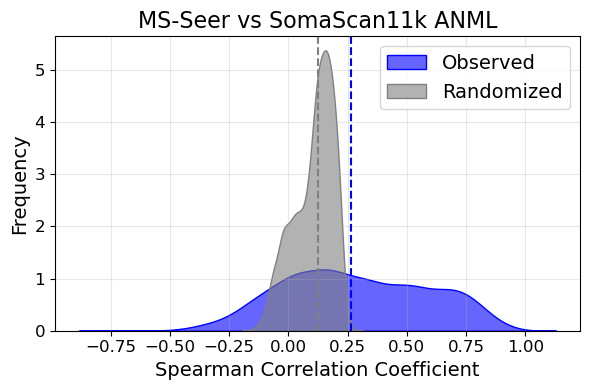

Wilcoxon statistic: 1551531.0, P-value: 3.1069829701240764e-213
T-statistic: 30.504646820130606, P-value: 5.042329766309635e-193
P-value for MS-Seer vs SomaScan11k pre-ANML: 5.0423e-193


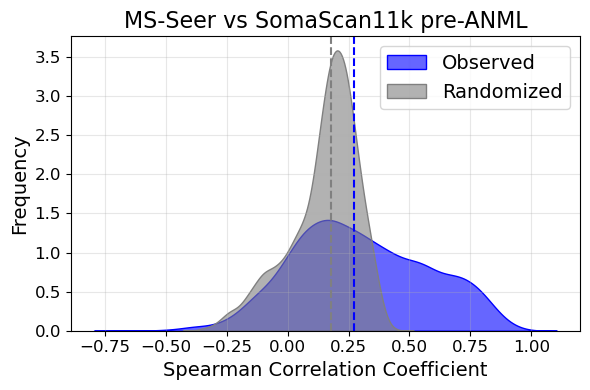

Wilcoxon statistic: 361805.0, P-value: 1.6690140578410214e-171
T-statistic: 32.80505100815528, P-value: 5.054867280958793e-211
P-value for MS-Seer vs OlinkHT: 5.0549e-211


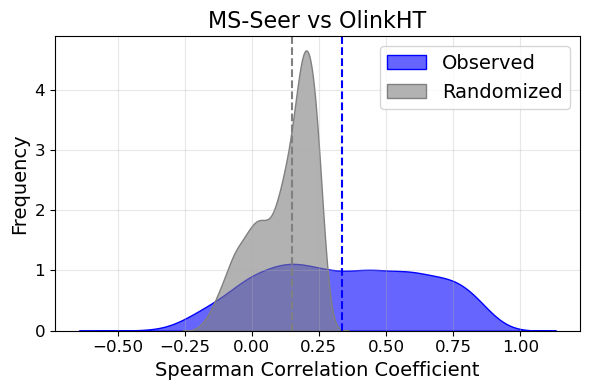

Wilcoxon statistic: 0.0, P-value: 0.0
T-statistic: 271.95784676093115, P-value: 0.0
P-value for SomaScan11k ANML vs SomaScan11k pre-ANML: 0.0000e+00


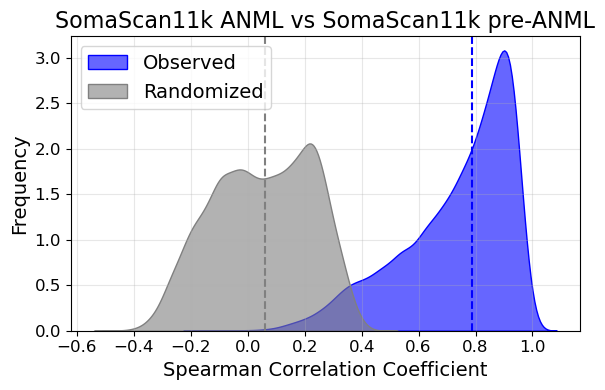

Wilcoxon statistic: 1200927.0, P-value: 2.8561678872935827e-260
T-statistic: 41.48708184955895, P-value: 0.0
P-value for SomaScan11k ANML vs OlinkHT: 0.0000e+00


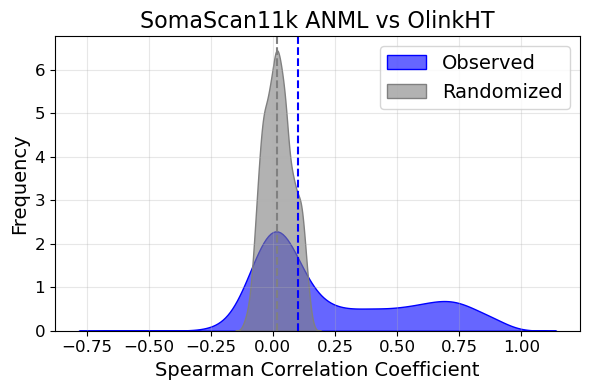

Wilcoxon statistic: 1688560.0, P-value: 1.0226176331760014e-160
T-statistic: 36.89457312876657, P-value: 8.756117409255538e-274
P-value for SomaScan11k pre-ANML vs OlinkHT: 8.7561e-274


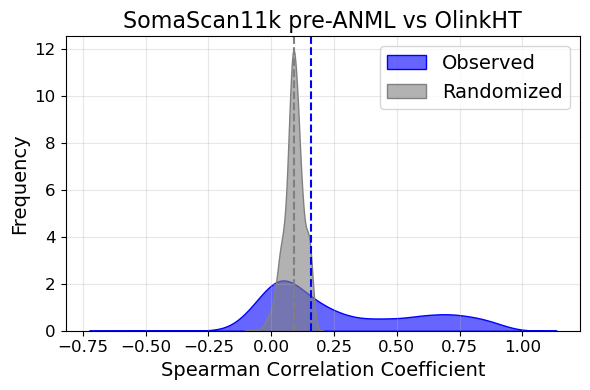

In [16]:
# plot the correlation values

def plot_correlation_distributions(data, null_data, title):

    fig, ax = plt.subplots(figsize=(6, 4))

    # Plot the distribution of actual correlation values and color them blue
    sns.kdeplot(data,color='blue', alpha=0.6, label='Observed', fill=True)
    #add median line
    plt.axvline(data.median(), color='blue', linestyle='--')

    # Plot the distribution of background correlation values and color them gray
    sns.kdeplot(null_data, color='gray', alpha=0.6, label='Randomized', fill=True)
    #add median line
    plt.axvline(null_data.median(), color='gray', linestyle='--')

    #use wilcoxon test to compare the two distributions
    from scipy.stats import wilcoxon
    stat, p_value = wilcoxon(data, null_data)
    print(f"Wilcoxon statistic: {stat}, P-value: {p_value}")
    from scipy.stats import ttest_ind
    t_stat, p_value = ttest_ind(data, null_data)
    print(f"T-statistic: {t_stat}, P-value: {p_value}")
    # Add text for p-value
    #print p-value
    print( f"P-value for {title}: {p_value:.4e}")


    ax.set_title(title, fontsize=16)
    ax.set_xlabel('Spearman Correlation Coefficient', fontsize=14)
    ax.set_ylabel('Frequency', fontsize=14)
    ax.grid(alpha=0.3)
    ax.legend(fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()
    plt.savefig(f'./correlation_plots/{title}.svg', format='svg', dpi=600)
    plt.show()

# Plot the correlation distributions
plot_correlation_distributions(tf_soma_anml_unique_corr, tf_soma_anml_unique_null.mean(axis=0), 'MS-Seer vs SomaScan11k ANML')
plot_correlation_distributions(tf_soma_preanml_unique_corr, tf_soma_preanml_unique_null.mean(axis=0), 'MS-Seer vs SomaScan11k pre-ANML')
plot_correlation_distributions(tf_olink_corr, tf_olink_null.mean(axis=0), 'MS-Seer vs OlinkHT')
plot_correlation_distributions(soma_anml_preanml_corr, soma_anml_preanml_null.mean(axis=0), 'SomaScan11k ANML vs SomaScan11k pre-ANML')
plot_correlation_distributions(soma_anml_olink_corr, soma_anml_olink_null.mean(axis=0), 'SomaScan11k ANML vs OlinkHT')
plot_correlation_distributions(soma_preanml_olink_corr, soma_preanml_olink_null.mean(axis=0), 'SomaScan11k pre-ANML vs OlinkHT')


In [17]:
# Please report the number and percentage of proteins that are more than 99 percentile of the mean background distribution

def report_high_correlation_proteins(data, null_data, platform_pair, threshold=0.99):
    """
    Reports the number and percentage of proteins with correlation values above a specified threshold.
    
    Parameters
    ----------
    data : pd.Series
        Series of observed correlation values.
    null_data : pd.Series
        Series of background correlation values.
    platform_pair : str
        Name of the platform pair being analyzed.
    threshold : float, optional
        Threshold for high correlation, default is 0.99 (99th percentile).
    
    Returns
    -------
    None
    """
    # Calculate the threshold value from the null distribution
    threshold_value = np.percentile(null_data, threshold * 100)
    
    # Count how many proteins exceed this threshold in the observed data
    high_corr_count = (data > threshold_value).sum()
    
    # Calculate the percentage of such proteins
    percentage = (high_corr_count / len(data)) * 100
    
    print(f"{platform_pair} - Number of proteins above {threshold * 100}% threshold: {high_corr_count}")
    print(f"{platform_pair} - Percentage of proteins above {threshold * 100}% threshold: {percentage:.2f}%")
    print(f"{platform_pair} - Total common proteins: {len(data)}")
    print("-" * 80)

# Report for each dataset
report_high_correlation_proteins(tf_soma_anml_unique_corr, tf_soma_anml_unique_null.mean(axis=0), "MS-Seer vs SomaScan11k ANML", threshold=0.99)
report_high_correlation_proteins(tf_soma_preanml_unique_corr, tf_soma_preanml_unique_null.mean(axis=0), "MS-Seer vs SomaScan11k pre-ANML", threshold=0.99)
report_high_correlation_proteins(tf_olink_corr, tf_olink_null.mean(axis=0), "MS-Seer vs OlinkHT", threshold=0.99)
report_high_correlation_proteins(soma_anml_preanml_corr, soma_anml_preanml_null.mean(axis=0), "SomaScan11k ANML vs SomaScan11k pre-ANML", threshold=0.99)
report_high_correlation_proteins(soma_anml_olink_corr, soma_anml_olink_null.mean(axis=0), "SomaScan11k ANML vs OlinkHT", threshold=0.99)
report_high_correlation_proteins(soma_preanml_olink_corr, soma_preanml_olink_null.mean(axis=0), "SomaScan11k pre-ANML vs OlinkHT", threshold=0.99)# Please report the number and percentage of proteins that are more than 99 percentile of the mean background distribution


MS-Seer vs SomaScan11k ANML - Number of proteins above 99.0% threshold: 2054
MS-Seer vs SomaScan11k ANML - Percentage of proteins above 99.0% threshold: 53.42%
MS-Seer vs SomaScan11k ANML - Total common proteins: 3845
--------------------------------------------------------------------------------
MS-Seer vs SomaScan11k pre-ANML - Number of proteins above 99.0% threshold: 1466
MS-Seer vs SomaScan11k pre-ANML - Percentage of proteins above 99.0% threshold: 38.13%
MS-Seer vs SomaScan11k pre-ANML - Total common proteins: 3845
--------------------------------------------------------------------------------
MS-Seer vs OlinkHT - Number of proteins above 99.0% threshold: 1218
MS-Seer vs OlinkHT - Percentage of proteins above 99.0% threshold: 56.18%
MS-Seer vs OlinkHT - Total common proteins: 2168
--------------------------------------------------------------------------------
SomaScan11k ANML vs SomaScan11k pre-ANML - Number of proteins above 99.0% threshold: 10042
SomaScan11k ANML vs SomaSca

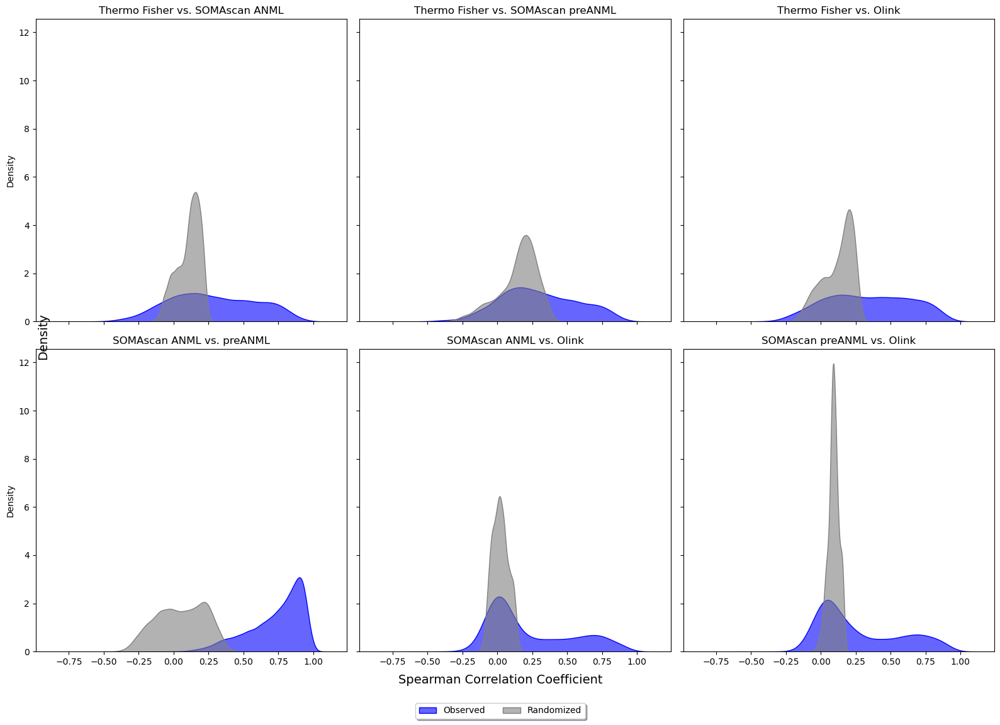

In [18]:
def plot_all_correlation_distributions_grid():
    # Define the data for each subplot
    plot_data = [
        (tf_soma_anml_unique_corr, tf_soma_anml_unique_null.mean(axis=0), 'Thermo Fisher vs. SOMAscan ANML'),
        (tf_soma_preanml_unique_corr, tf_soma_preanml_unique_null.mean(axis=0), 'Thermo Fisher vs. SOMAscan preANML'),
        (tf_olink_corr, tf_olink_null.mean(axis=0), 'Thermo Fisher vs. Olink'),
        (soma_anml_preanml_corr, soma_anml_preanml_null.mean(axis=0), 'SOMAscan ANML vs. preANML'),
        (soma_anml_olink_corr, soma_anml_olink_null.mean(axis=0), 'SOMAscan ANML vs. Olink'),
        (soma_preanml_olink_corr, soma_preanml_olink_null.mean(axis=0), 'SOMAscan preANML vs. Olink')
    ]
    
    # Create a 3x2 grid of subplots with shared axes
    fig, axes = plt.subplots(2, 3, figsize=(16, 12), sharex=True, sharey=True)
    axes = axes.flatten()  # Flatten the 2D array of axes for easier indexing
    
    # Plot each distribution
    for i, (data, null_data, title) in enumerate(plot_data):
        ax = axes[i]
        
        # Plot observed correlations
        sns.kdeplot(data, color='blue', alpha=0.6, label='Observed', fill=True, ax=ax)
        
        # Plot randomized correlations
        sns.kdeplot(null_data, color='gray', alpha=0.6, label='Randomized', fill=True, ax=ax)
        
        # Set title for each subplot
        ax.set_title(title)
        
        # Only include legend for the last subplot
        if i == len(plot_data) - 1:
            handles, labels = ax.get_legend_handles_labels()
        
        # Remove individual legends
        if ax.get_legend() is not None:
            ax.get_legend().remove()
    
    # Add a common x and y label
    fig.text(0.5, 0.04, 'Spearman Correlation Coefficient', ha='center', fontsize=14)
    fig.text(0.04, 0.5, 'Density', va='center', rotation='vertical', fontsize=14)
    
    # Add a common legend
    fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.02), 
               ncol=2, fancybox=True, shadow=True)
    
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])  # Adjust layout to make room for common labels
    plt.show()

# Call the function to create the grid plot
plot_all_correlation_distributions_grid()

In [20]:
# set-wise breakdown of Olink proteins

def return_protein_list_olink(protein_set):
    #read xlsx file
    df1 = pd.read_excel('../platform_analytes_list/explore-1536-assay-list-20210227-web-1.xlsx', header=1)
    uniprot_list_v1 = df1['Uniprot ID'].tolist()
    
    df2 = pd.read_excel('../platform_analytes_list/olink-explore-3072-validation-data-results.xlsx', header=1)
    uniprot_list_v2 = df2['UniProt'].tolist()
    #display(df2.head())

    df3 = pd.read_csv('../data/olink/Preprocessed_data/Olink_Assay_Annotation_Unique.csv',header=0)
    #display(df3.head())
    data3 = df3.loc[:, ['OlinkID', 'UniProt']]
    #display(data3.head())
    uniprot_list_v3 = df3['UniProt'].tolist()

    uniprot_to_olinkid = dict(zip(data3['UniProt'], data3['OlinkID']))

    df_lod = pd.read_csv("../data/olink/Preprocessed_data_intensity_normalized/Olink_HighProportionProteins_0.2_Intensity.csv")
    uniprot_lod = df_lod['UniProt'].to_list()

    #function to convert uniprot to olinkid
    def convert_uniprot_to_olinkid(uniprot_list, uniprot_to_olinkid):
        return list(filter(None, map(lambda uniprot: uniprot_to_olinkid.get(uniprot), uniprot_list)))
    if protein_set == 1:
        uniprot_list_set1 = uniprot_list_v1
        return list(uniprot_list_set1)
    elif protein_set == 2:
        uniprot_list_set2 = list(set(uniprot_list_v2) - set(uniprot_list_v1))
        return uniprot_list_set2
    elif protein_set == 3:
        uniprot_list_set3 = list(set(set(uniprot_list_v3) - set(uniprot_list_v2)) - set(uniprot_list_v1))
        return uniprot_list_set3
    elif protein_set == 4:
        return uniprot_list_v2

In [24]:
# read the inforamtion on different platform versions
def return_soma_anml_list(proteinlist):
    #read xlsx file
    df1 = pd.read_excel('../platform_analytes_list/somalogic_5k.xlsx', header=1)
    #display(df1.head())
    uniprot_list_v1 = df1['UniProt'].tolist()

    df2 = pd.read_excel('../platform_analytes_list/somalogic_7k.xlsx', header=1)
    #display(df2.head())
    uniprot_list_v2 = df2['UniProt'].tolist()

    df3 = pd.read_csv('../data/somalogic/Preprocessed_data/Somalogic_Analyte_Annotation_All.csv',header=0)
    #display(df3.head())
    data3 = df3.loc[:, ['SeqId', 'UniProt']]
    uniprot_list_v3 = df3['UniProt'].tolist()

    df_lod = pd.read_csv("../data/somalogic/Preprocessed_data/SomaLogic_HighProportionProteins_0.2.csv")
    aptname_lod = df_lod['AptName'].to_list()
    uniprot_lod = df_lod['UniProt'].to_list()
    
    uniprot_list_set1 = uniprot_list_v1
    uniprot_list_set2 = list(set(uniprot_list_v2) - set(uniprot_list_v1))
    uniprot_list_set3 = list(set(uniprot_list_v3) - set(uniprot_list_v2))

    set1 = set(proteinlist) & set(uniprot_list_set1)
    set2 = set(proteinlist) & set(uniprot_list_set2)
    set3 = set(proteinlist) & set(uniprot_list_set3)
    lod = set(proteinlist) & set(uniprot_lod)

    return list(set1), list(set2), list(set3), list(lod)


#breakdown of tf vs soma anml

tf_soma_anml_set1, tf_soma_anml_set2, tf_soma_anml_set3, tf_soma_anml_lod = return_soma_anml_list(list(tf_soma_anml_unique_corr.index))

print ("Thermo Fisher vs. SOMAscan ANML (Unique) Set 1 Length:", len(tf_soma_anml_set1))
print ("Thermo Fisher vs. SOMAscan ANML (Unique) Set 2 Length:", len(tf_soma_anml_set2))
print ("Thermo Fisher vs. SOMAscan ANML (Unique) Set 3 Length:", len(tf_soma_anml_set3))
print ("Thermo Fisher vs. SOMAscan ANML (Unique) Below LOD Length:", len(tf_soma_anml_lod))
print("Thermo Fisher vs. SOMAscan ANML (Unique) Above LOD Length:", len(tf_soma_anml_unique_corr.loc[~tf_soma_anml_unique_corr.index.isin(tf_soma_anml_lod)]))

print("Thermo Fisher vs. SOMAscan ANML (Unique) Set 1:", tf_soma_anml_unique_corr.loc[tf_soma_anml_set1].median())
print("Thermo Fisher vs. SOMAscan ANML (Unique) Set 2:", tf_soma_anml_unique_corr.loc[tf_soma_anml_set2].median())
print("Thermo Fisher vs. SOMAscan ANML (Unique) Set 3:", tf_soma_anml_unique_corr.loc[tf_soma_anml_set3].median())
print("Thermo Fisher vs. SOMAscan ANML (Unique) Below LOD:", tf_soma_anml_unique_corr.loc[tf_soma_anml_lod].median())
print("Thermo Fisher vs. SOMAscan ANML (Unique) Above LOD:", tf_soma_anml_unique_corr.loc[~tf_soma_anml_unique_corr.index.isin(tf_soma_anml_lod)].median())




Thermo Fisher vs. SOMAscan ANML (Unique) Set 1 Length: 2282
Thermo Fisher vs. SOMAscan ANML (Unique) Set 2 Length: 628
Thermo Fisher vs. SOMAscan ANML (Unique) Set 3 Length: 935
Thermo Fisher vs. SOMAscan ANML (Unique) Below LOD Length: 111
Thermo Fisher vs. SOMAscan ANML (Unique) Above LOD Length: 3734
Thermo Fisher vs. SOMAscan ANML (Unique) Set 1: 0.312981806968856
Thermo Fisher vs. SOMAscan ANML (Unique) Set 2: 0.3066913351834721
Thermo Fisher vs. SOMAscan ANML (Unique) Set 3: 0.16189213366110894
Thermo Fisher vs. SOMAscan ANML (Unique) Below LOD: 0.0058587727412889295
Thermo Fisher vs. SOMAscan ANML (Unique) Above LOD: 0.27277212457600986


In [26]:
# read the inforamtion on different platform versions
def return_soma_preanml_list(proteinlist):
    #read xlsx file
    df1 = pd.read_excel('../platform_analytes_list/somalogic_5k.xlsx', header=1)
    #display(df1.head())
    uniprot_list_v1 = df1['UniProt'].tolist()

    df2 = pd.read_excel('../platform_analytes_list/somalogic_7k.xlsx', header=1)
    #display(df2.head())
    uniprot_list_v2 = df2['UniProt'].tolist()

    df3 = pd.read_csv('../data/somalogic/Preprocessed_data_preANML/Somalogic_Analyte_Annotation_All.csv',header=0)
    #display(df3.head())
    data3 = df3.loc[:, ['SeqId', 'UniProt']]
    uniprot_list_v3 = df3['UniProt'].tolist()

    df_lod = pd.read_csv("../data/somalogic/Preprocessed_data_preANML/SomaLogic_HighProportionProteins_0.2.csv")
    aptname_lod = df_lod['AptName'].to_list()
    uniprot_lod = df_lod['UniProt'].to_list()
    
    uniprot_list_set1 = uniprot_list_v1
    uniprot_list_set2 = list(set(uniprot_list_v2) - set(uniprot_list_v1))
    uniprot_list_set3 = list(set(uniprot_list_v3) - set(uniprot_list_v2))

    set1 = set(proteinlist) & set(uniprot_list_set1)
    set2 = set(proteinlist) & set(uniprot_list_set2)
    set3 = set(proteinlist) & set(uniprot_list_set3)
    lod = set(proteinlist) & set(uniprot_lod)

    return list(set1), list(set2), list(set3), list(lod)


#breakdown of tf vs soma preanml

tf_soma_preanml_set1, tf_soma_preanml_set2, tf_soma_preanml_set3, tf_soma_preanml_lod = return_soma_preanml_list(list(tf_soma_preanml_unique_corr.index))

print ("Thermo Fisher vs. SOMAscan preANML (Unique) Set 1 Length:", len(tf_soma_preanml_set1))
print ("Thermo Fisher vs. SOMAscan preANML (Unique) Set 2 Length:", len(tf_soma_preanml_set2))
print ("Thermo Fisher vs. SOMAscan preANML (Unique) Set 3 Length:", len(tf_soma_preanml_set3))
print ("Thermo Fisher vs. SOMAscan preANML (Unique) Below LOD Length:", len(tf_soma_preanml_lod))
print("Thermo Fisher vs. SOMAscan preANML (Unique) Above LOD Length:", len(tf_soma_preanml_unique_corr.loc[~tf_soma_preanml_unique_corr.index.isin(tf_soma_preanml_lod)]))

print("Thermo Fisher vs. SOMAscan preANML (Unique) Set 1:", tf_soma_preanml_unique_corr.loc[tf_soma_preanml_set1].median())
print("Thermo Fisher vs. SOMAscan preANML (Unique) Set 2:", tf_soma_preanml_unique_corr.loc[tf_soma_preanml_set2].median())
print("Thermo Fisher vs. SOMAscan preANML (Unique) Set 3:", tf_soma_preanml_unique_corr.loc[tf_soma_preanml_set3].median())
print("Thermo Fisher vs. SOMAscan preANML (Unique) Below LOD:", tf_soma_preanml_unique_corr.loc[tf_soma_preanml_lod].median())
print("Thermo Fisher vs. SOMAscan preANML (Unique) Above LOD:", tf_soma_preanml_unique_corr.loc[~tf_soma_preanml_unique_corr.index.isin(tf_soma_preanml_lod)].median())




Thermo Fisher vs. SOMAscan preANML (Unique) Set 1 Length: 2282
Thermo Fisher vs. SOMAscan preANML (Unique) Set 2 Length: 628
Thermo Fisher vs. SOMAscan preANML (Unique) Set 3 Length: 935
Thermo Fisher vs. SOMAscan preANML (Unique) Below LOD Length: 48
Thermo Fisher vs. SOMAscan preANML (Unique) Above LOD Length: 3797
Thermo Fisher vs. SOMAscan preANML (Unique) Set 1: 0.3041058297133422
Thermo Fisher vs. SOMAscan preANML (Unique) Set 2: 0.31248843663274745
Thermo Fisher vs. SOMAscan preANML (Unique) Set 3: 0.18556891766882516
Thermo Fisher vs. SOMAscan preANML (Unique) Below LOD: 0.08208448967005857
Thermo Fisher vs. SOMAscan preANML (Unique) Above LOD: 0.27733580018501386


In [27]:
# read the information for olink proteins

def return_olink_list(proteinlist):
    #read xlsx file
    df1 = pd.read_excel('../platform_analytes_list/explore-1536-assay-list-20210227-web-1.xlsx', header=1)
    uniprot_list_v1 = df1['Uniprot ID'].tolist()
    
    df2 = pd.read_excel('../platform_analytes_list/olink-explore-3072-validation-data-results.xlsx', header=1)
    uniprot_list_v2 = df2['UniProt'].tolist()
    #display(df2.head())

    df3 = pd.read_csv('../data/olink/Preprocessed_data_intensity_normalized/Olink_Assay_Annotation_Unique.csv',header=0)
    #display(df3.head())
    data3 = df3.loc[:, ['OlinkID', 'UniProt']]
    #display(data3.head())
    uniprot_list_v3 = df3['UniProt'].tolist()

    uniprot_to_olinkid = dict(zip(data3['UniProt'], data3['OlinkID']))

    df_lod = pd.read_csv("../data/olink/Preprocessed_data_intensity_normalized/Olink_HighProportionProteins_0.2_Intensity.csv")
    uniprot_lod = df_lod['UniProt'].to_list()
    
    uniprot_list_set1 = uniprot_list_v1
    uniprot_list_set2 = list(set(uniprot_list_v2) - set(uniprot_list_v1))
    uniprot_list_set3 = list(set(uniprot_list_v3) - set(uniprot_list_v2))
    
    set1 = set(proteinlist) & set(uniprot_list_set1)
    set2 = set(proteinlist) & set(uniprot_list_set2)
    set3 = set(proteinlist) & set(uniprot_list_set3)
    lod = set(proteinlist) & set(uniprot_lod)

    return list(set1), list(set2), list(set3), list(lod)



In [29]:

#breakdown of tf vs olink

tf_olink_set1, tf_olink_set2, tf_olink_set3, tf_olink_lod = return_olink_list(list(tf_olink_corr.index))

print ("Thermo Fisher vs. Olink Length Set 1:", len(tf_olink_set1))
print ("Thermo Fisher vs. Olink Length Set 2:", len(tf_olink_set2))
print ("Thermo Fisher vs. Olink Length Set 3:", len(tf_olink_set3))
print ("Thermo Fisher vs. Olink Length Below LOD:", len(tf_olink_lod))
print("Thermo Fisher vs. Olink Length Above LOD:", len(tf_olink_corr.loc[~tf_olink_corr.index.isin(tf_olink_lod)]))

print("Thermo Fisher vs. Olink Set 1:", tf_olink_corr.loc[tf_olink_set1].median())
print("Thermo Fisher vs. Olink Set 2:", tf_olink_corr.loc[tf_olink_set2].median())
print("Thermo Fisher vs. Olink Set 3:", tf_olink_corr.loc[tf_olink_set3].median())
print("Thermo Fisher vs. Olink Below LOD:", tf_olink_corr.loc[tf_olink_lod].median())
print("Thermo Fisher vs. Olink Above LOD:", tf_olink_corr.loc[~tf_olink_corr.index.isin(tf_olink_lod)].median())

Thermo Fisher vs. Olink Length Set 1: 852
Thermo Fisher vs. Olink Length Set 2: 731
Thermo Fisher vs. Olink Length Set 3: 585
Thermo Fisher vs. Olink Length Below LOD: 779
Thermo Fisher vs. Olink Length Above LOD: 1389
Thermo Fisher vs. Olink Set 1: 0.4378661732963306
Thermo Fisher vs. Olink Set 2: 0.32778291705211227
Thermo Fisher vs. Olink Set 3: 0.16978106691335182
Thermo Fisher vs. Olink Below LOD: 0.12562442183163736
Thermo Fisher vs. Olink Above LOD: 0.48011100832562437


In [30]:
# break of soma anml vs olink

soma_anml_olink_set1, soma_anml_olink_set2, soma_anml_olink_set3, soma_anml_olink_lod = return_olink_list(list(soma_anml_olink_corr.index))

print ("SOMAscan ANML vs. Olink Length Set 1:", len(soma_anml_olink_set1))
print ("SOMAscan ANML vs. Olink Length Set 2:", len(soma_anml_olink_set2))
print ("SOMAscan ANML vs. Olink Length Set 3:", len(soma_anml_olink_set3))
print ("SOMAscan ANML vs. Olink Length Below LOD:", len(soma_anml_olink_lod))
print("SOMAscan ANML vs. Olink Length Above LOD:", len(soma_anml_olink_corr.loc[~soma_anml_olink_corr.index.isin(soma_anml_olink_lod)]))

print("SOMAscan ANML vs. Olink Set 1:", soma_anml_olink_corr.loc[soma_anml_olink_set1].median())
print("SOMAscan ANML vs. Olink Set 2:", soma_anml_olink_corr.loc[soma_anml_olink_set2].median())
print("SOMAscan ANML vs. Olink Set 3:", soma_anml_olink_corr.loc[soma_anml_olink_set3].median())
print("SOMAscan ANML vs. Olink Below LOD:", soma_anml_olink_corr.loc[soma_anml_olink_lod].median())
print("SOMAscan ANML vs. Olink Above LOD:", soma_anml_olink_corr.loc[~soma_anml_olink_corr.index.isin(soma_anml_olink_lod)].median())

SOMAscan ANML vs. Olink Length Set 1: 1316
SOMAscan ANML vs. Olink Length Set 2: 1122
SOMAscan ANML vs. Olink Length Set 3: 1280
SOMAscan ANML vs. Olink Length Below LOD: 1837
SOMAscan ANML vs. Olink Length Above LOD: 1881
SOMAscan ANML vs. Olink Set 1: 0.38424783609358315
SOMAscan ANML vs. Olink Set 2: 0.11912715642369134
SOMAscan ANML vs. Olink Set 3: 0.026857333551255858
SOMAscan ANML vs. Olink Below LOD: 0.027326604635300324
SOMAscan ANML vs. Olink Above LOD: 0.42849653737738036


In [31]:
# break of soma preanml vs olink

soma_preanml_olink_set1, soma_preanml_olink_set2, soma_preanml_olink_set3, soma_preanml_olink_lod = return_olink_list(list(soma_preanml_olink_corr.index))

print ("SOMAscan preANML vs. Olink Length Set 1:", len(soma_preanml_olink_set1))
print ("SOMAscan preANML vs. Olink Length Set 2:", len(soma_preanml_olink_set2))
print ("SOMAscan preANML vs. Olink Length Set 3:", len(soma_preanml_olink_set3))
print ("SOMAscan preANML vs. Olink Length Below LOD:", len(soma_preanml_olink_lod))
print("SOMAscan preANML vs. Olink Length Above LOD:", len(soma_preanml_olink_corr.loc[~soma_preanml_olink_corr.index.isin(soma_preanml_olink_lod)]))

print("SOMAscan preANML vs. Olink Set 1:", soma_preanml_olink_corr.loc[soma_preanml_olink_set1].median())
print("SOMAscan preANML vs. Olink Set 2:", soma_preanml_olink_corr.loc[soma_preanml_olink_set2].median())
print("SOMAscan preANML vs. Olink Set 3:", soma_preanml_olink_corr.loc[soma_preanml_olink_set3].median())
print("SOMAscan preANML vs. Olink Below LOD:", soma_preanml_olink_corr.loc[soma_preanml_olink_lod].median())
print("SOMAscan preANML vs. Olink Above LOD:", soma_preanml_olink_corr.loc[~soma_preanml_olink_corr.index.isin(soma_preanml_olink_lod)].median())

SOMAscan preANML vs. Olink Length Set 1: 1316
SOMAscan preANML vs. Olink Length Set 2: 1122
SOMAscan preANML vs. Olink Length Set 3: 1280
SOMAscan preANML vs. Olink Length Below LOD: 1837
SOMAscan preANML vs. Olink Length Above LOD: 1881
SOMAscan preANML vs. Olink Set 1: 0.42416063088831946
SOMAscan preANML vs. Olink Set 2: 0.182881868621473
SOMAscan preANML vs. Olink Set 3: 0.06256192024617441
SOMAscan preANML vs. Olink Below LOD: 0.05798534692761153
SOMAscan preANML vs. Olink Above LOD: 0.46254613133825123
